In [1]:
import glob
import datetime  
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from mpl_toolkits.basemap import Basemap
import matplotlib.colors as co

In [3]:
kt2ms = 0.514444

cat_name   = ['TD', 'TS', 'HU1', 'HU2', 'HU3', 'HU4','HU5']
cat_thresh = np.array([34.,   63.,   82.,   95.,   112., 136.])
colors = {'TD': 'blue', 
          'TS': 'green', 
          'HU1': 'cyan', 
          'HU2': 'gold', 
          'HU3': 'coral', 
          'HU4': 'crimson',
          'HU5': 'brown'}

legend_order = {'TD': 0, 
          'TS': 1, 
          'HU1': 2, 
          'HU2': 3, 
          'HU3': 4, 
          'HU4': 5,
          'HU5': 6}

cat_thresh_ms = cat_thresh*kt2ms

CPU times: user 9.33 s, sys: 116 ms, total: 9.45 s
Wall time: 10.4 s


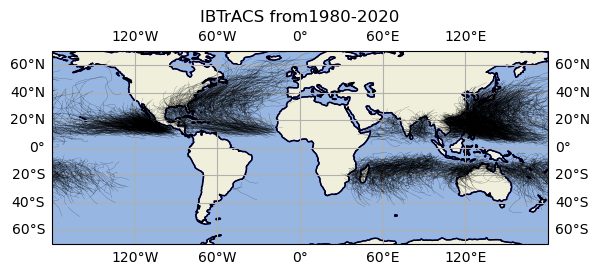

In [69]:
%%time
#https://blog.csdn.net/shayuxing/article/details/124006042

dir_data = '/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/'
dir_hr   = '/glade/campaign/mmm/c3we/done/pcast/CESM_HR/'
cat_name   = ['TD', 'TS', 'HU1', 'HU2', 'HU3', 'HU4','HU5']
cat_thresh = np.array([34.,   63.,   82.,   95.,   112., 136.])
ms2kt = 1.94384
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)

year_s = 1980
year_e = 2020

flnm_ib = '/glade/work/mingge/TC_DBS/IBTrACS.ALL.v04r00.nc'
ds = xr.open_dataset(flnm_ib)

lat = ds.usa_lat
lon = ds.usa_lon
stormYear = ds.season.data  # year based on season
number = ds.number.data
time2d = ds.iso_time.data
basin = ds.basin.data
basin1 = basin[:,0]
tracktype = ds.track_type.data

tcmask = np.where((stormYear >= year_s) &(stormYear <= year_e)) # (basin1==b'NA') & (tracktype==b'main'))

latselect = lat[tcmask]
lonselect = lon[tcmask]
timeselect = time2d[tcmask]
numberselect = number[tcmask]

# no fig
#fig = plt.subplots(figsize=(12,8))

ax = plt.axes(projection=ccrs.PlateCarree())
#ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=-180))
ax.coastlines()
ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
ax.set_extent([-180, 180, -70, 70])

ax.add_feature(cfeature.OCEAN)
ax.set_title('IBTrACS from' + str(year_s) + '-' + str(year_e))
ax.add_feature(cfeature.LAND, edgecolor='b')

for ii in range(len(numberselect)):
    lat_1d = np.array(latselect[ii,:])
    lat_1d = lat_1d[~np.isnan(lat_1d)]
    lon_1d = np.array(lonselect[ii,:])
    lon_1d = lon_1d[~np.isnan(lon_1d)]
    if len(lon_1d)>0:
        if (lon_1d.max() - lon_1d.min()) >180:
            # discontinue at longitude 0
            lon_1d =np.where(lon_1d < 0, lon_1d+360, lon_1d)
            #print(lon_1d)
             
        ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree())
        #cb = ax.scatter(lon_1d, lat_1d, s=5, transform=ccrs.PlateCarree()) 

### WeakThreshold 100 member

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.010_1850-2100_WeakThreshold.txt


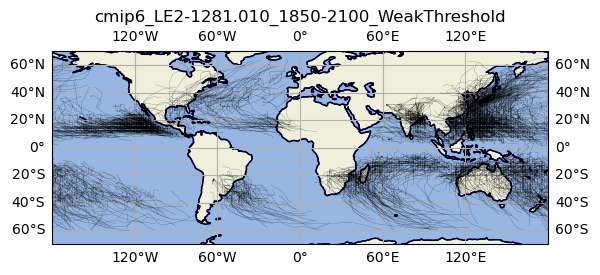

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.018_1850-2100_WeakThreshold.txt


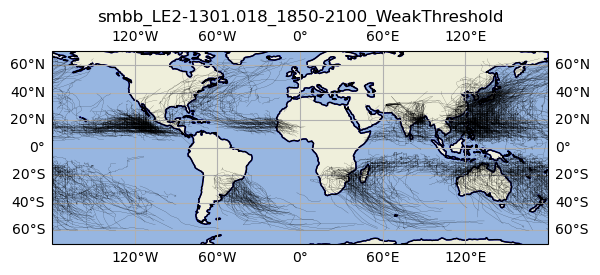

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.005_1850-2100_WeakThreshold.txt


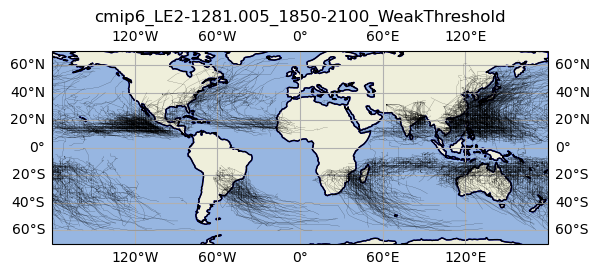

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.004_1850-2100_WeakThreshold.txt


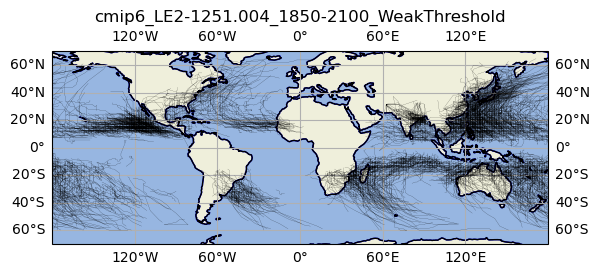

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.002_1850-2100_WeakThreshold.txt


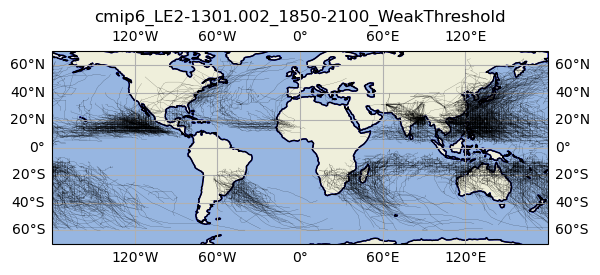

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1001.001_1850-2100_WeakThreshold.txt


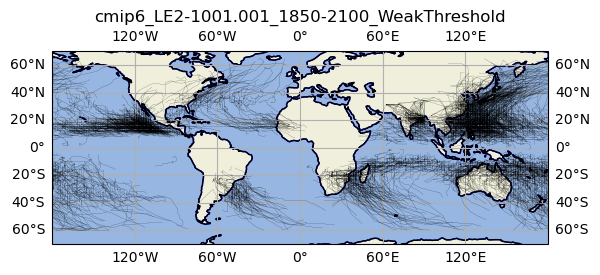

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.003_1850-2100_WeakThreshold.txt


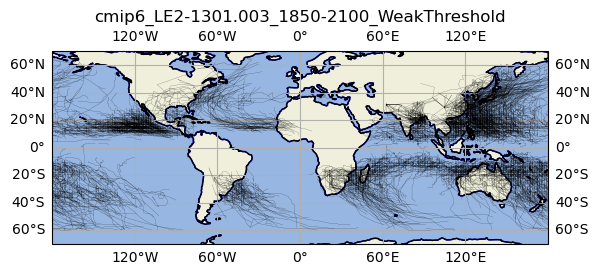

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.019_1850-2100_WeakThreshold.txt


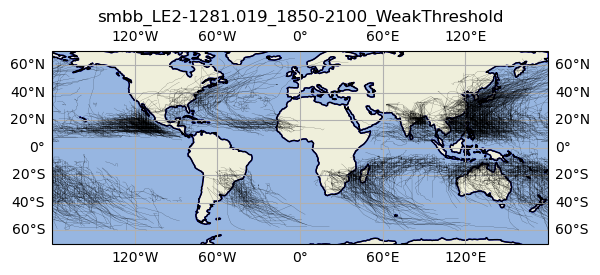

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1061.004_1850-2100_WeakThreshold.txt


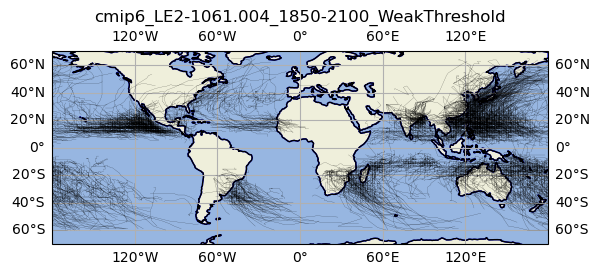

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.015_1850-2100_WeakThreshold.txt


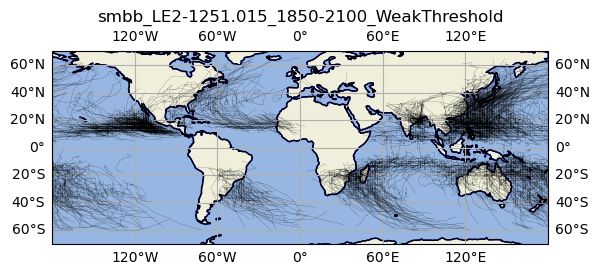

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1151.008_1850-2100_WeakThreshold.txt


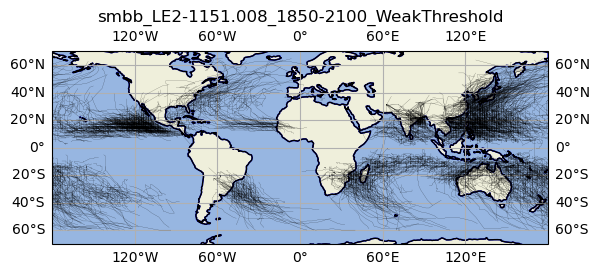

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.012_1850-2100_WeakThreshold.txt


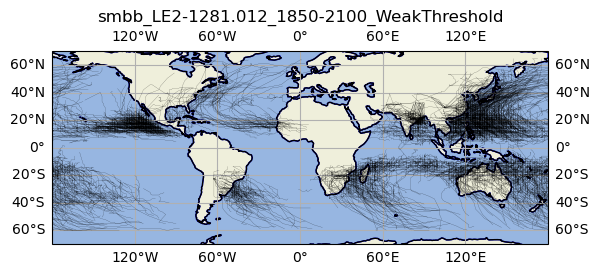

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1051.003_1850-2100_WeakThreshold.txt


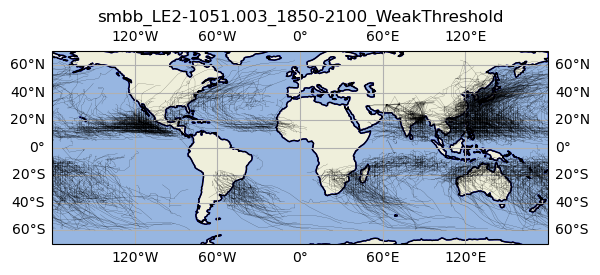

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.016_1850-2100_WeakThreshold.txt


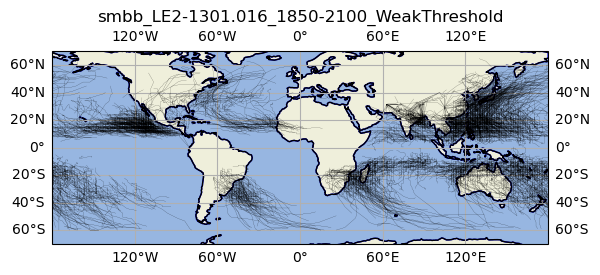

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.015_1850-2100_WeakThreshold.txt


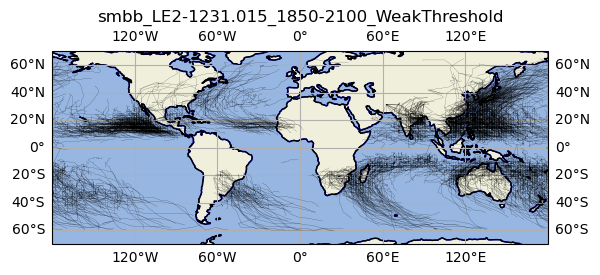

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.006_1850-2100_WeakThreshold.txt


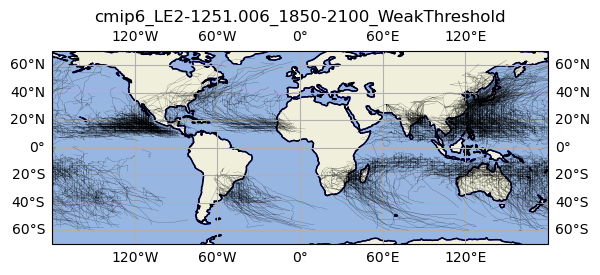

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.004_1850-2100_WeakThreshold.txt


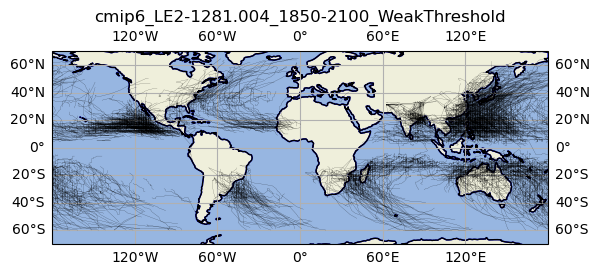

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1031.002_1850-2100_WeakThreshold.txt


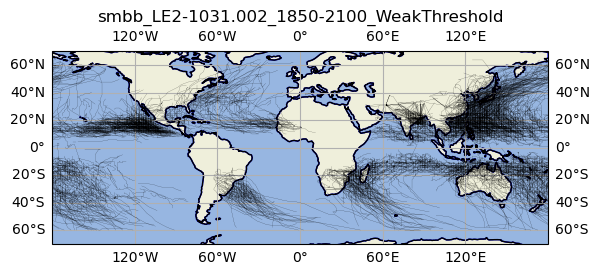

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.013_1850-2100_WeakThreshold.txt


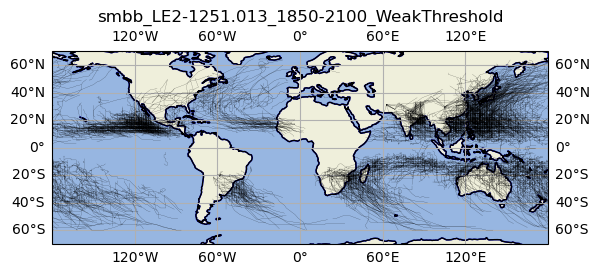

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.011_1850-2100_WeakThreshold.txt


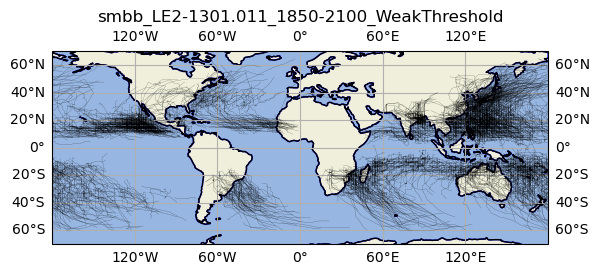

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.003_1850-2100_WeakThreshold.txt


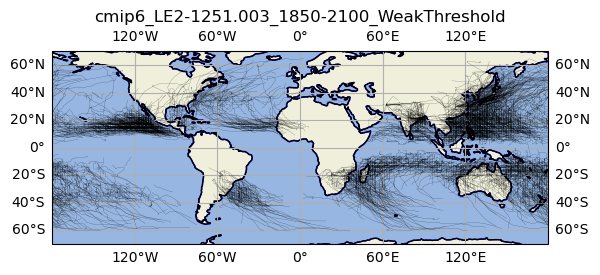

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.014_1850-2100_WeakThreshold.txt


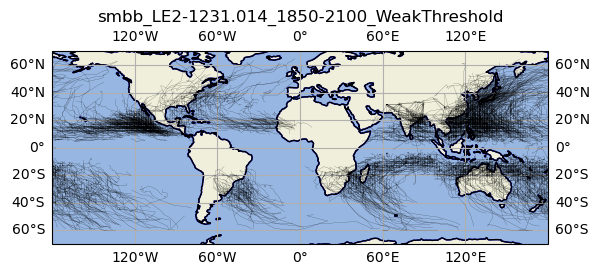

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.016_1850-2100_WeakThreshold.txt


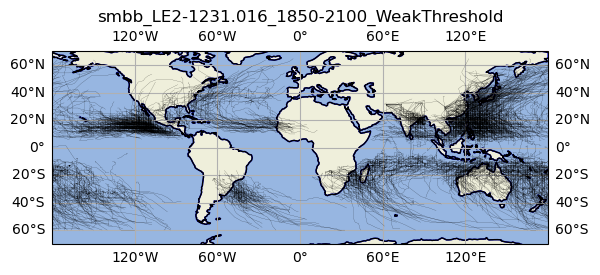

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1091.005_1850-2100_WeakThreshold.txt


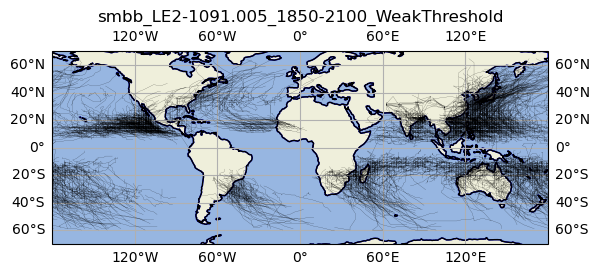

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.015_1850-2100_WeakThreshold.txt


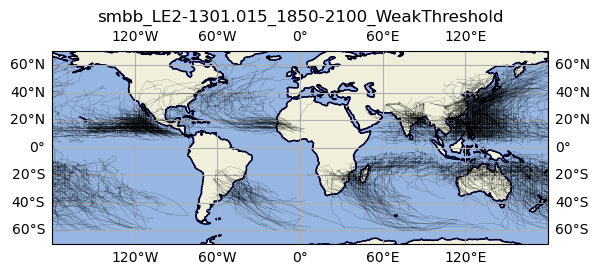

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.002_1850-2100_WeakThreshold.txt


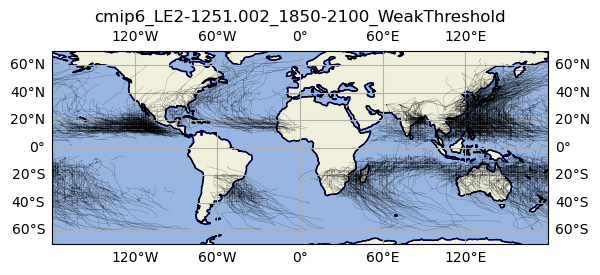

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1141.008_1850-2100_WeakThreshold.txt


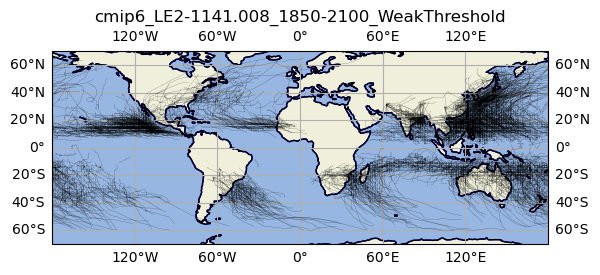

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.008_1850-2100_WeakThreshold.txt


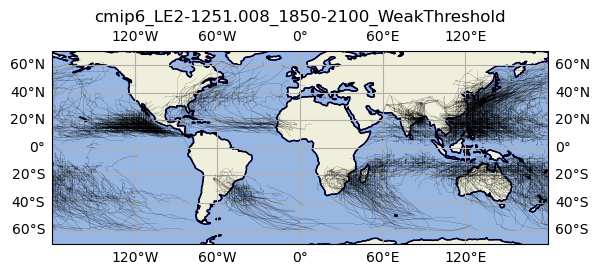

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.010_1850-2100_WeakThreshold.txt


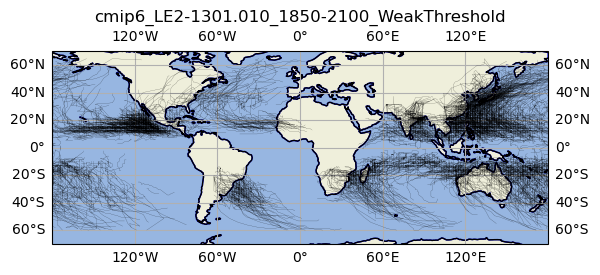

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1011.001_1850-2100_WeakThreshold.txt


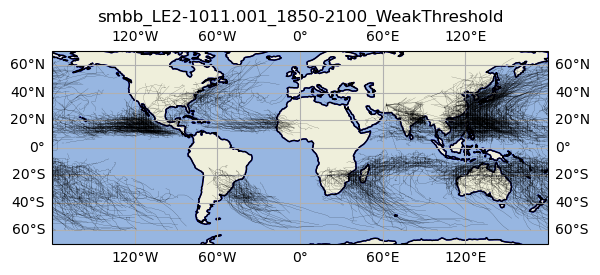

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.008_1850-2100_WeakThreshold.txt


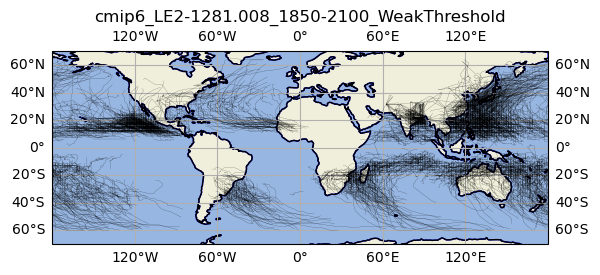

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.011_1850-2100_WeakThreshold.txt


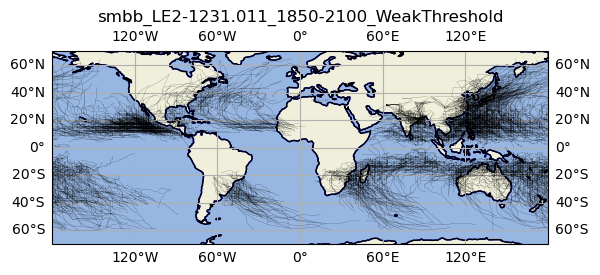

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.009_1850-2100_WeakThreshold.txt


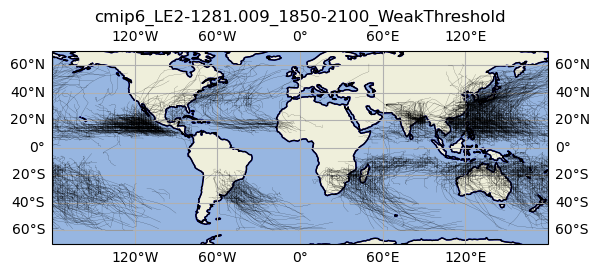

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.001_1850-2100_WeakThreshold.txt


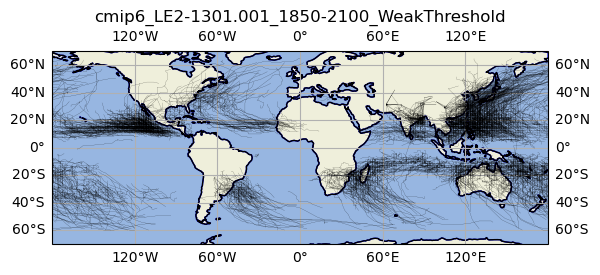

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.007_1850-2100_WeakThreshold.txt


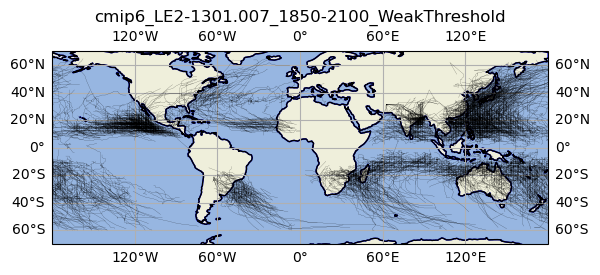

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.019_1850-2100_WeakThreshold.txt


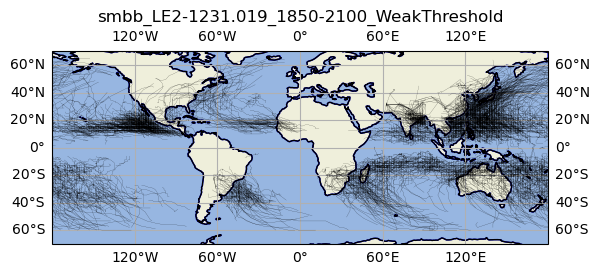

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.012_1850-2100_WeakThreshold.txt


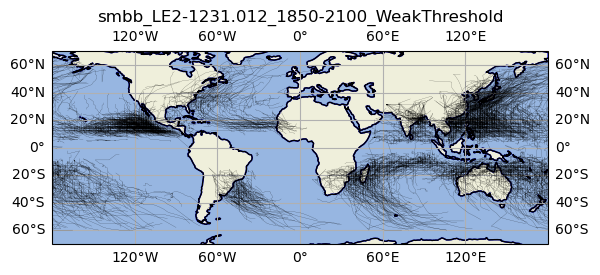

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.010_1850-2100_WeakThreshold.txt


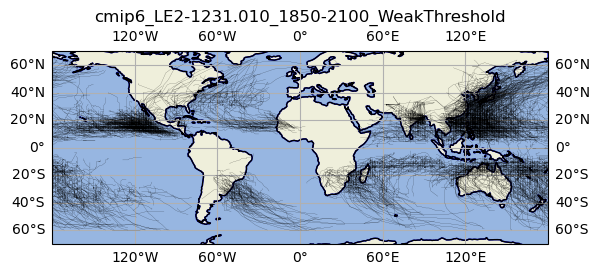

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.003_1850-2100_WeakThreshold.txt


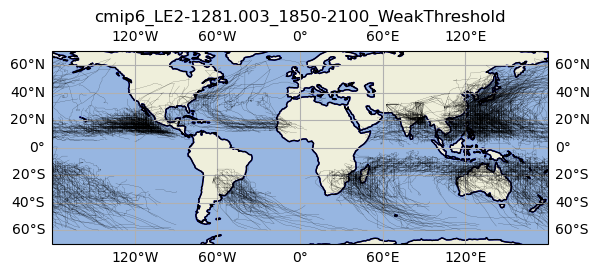

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.018_1850-2100_WeakThreshold.txt


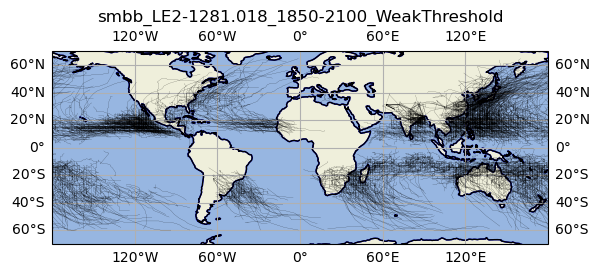

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.010_1850-2100_WeakThreshold.txt


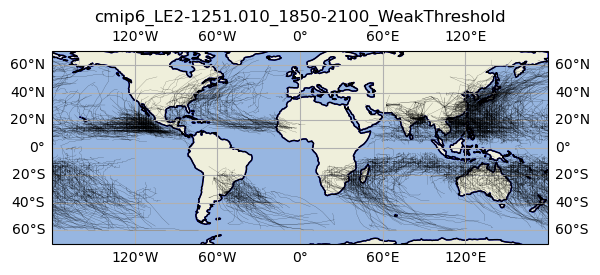

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.004_1850-2100_WeakThreshold.txt


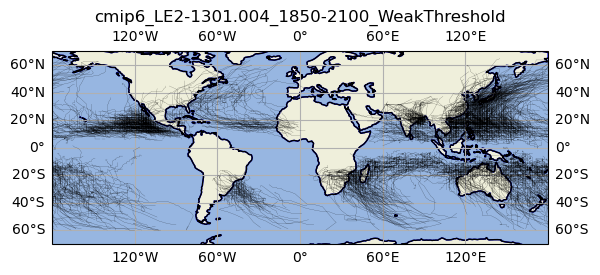

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.005_1850-2100_WeakThreshold.txt


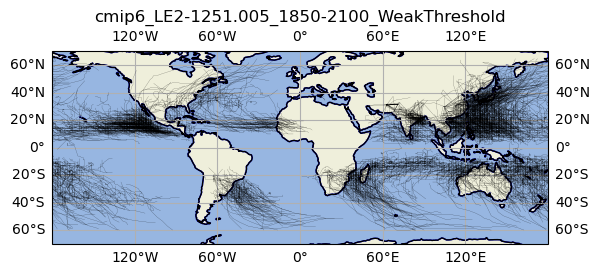

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1161.009_1850-2100_WeakThreshold.txt


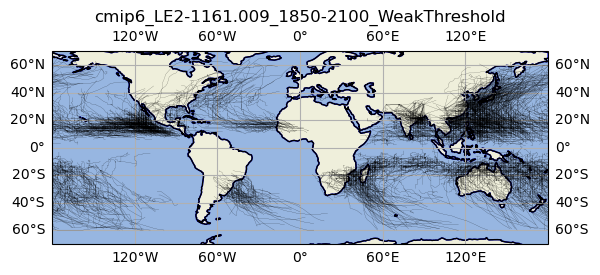

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.007_1850-2100_WeakThreshold.txt


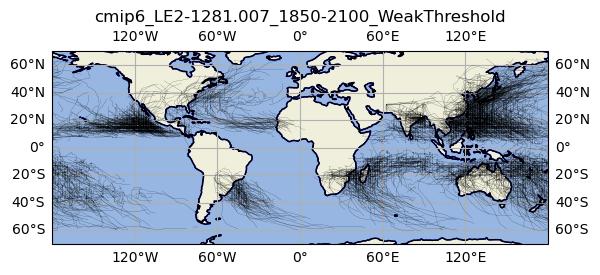

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.014_1850-2100_WeakThreshold.txt


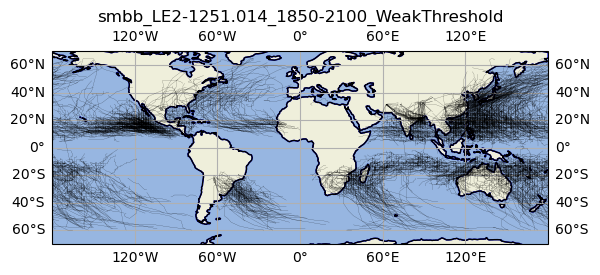

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.017_1850-2100_WeakThreshold.txt


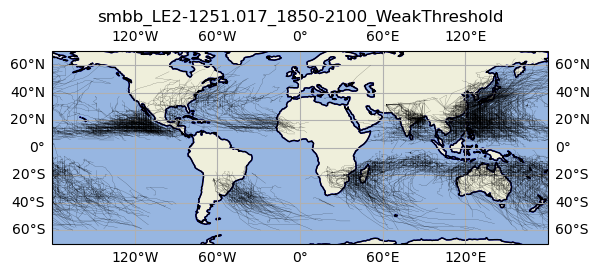

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.015_1850-2100_WeakThreshold.txt


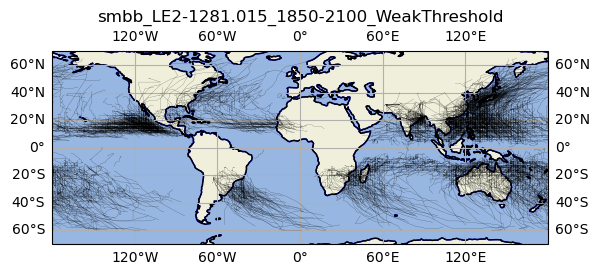

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.002_1850-2100_WeakThreshold.txt


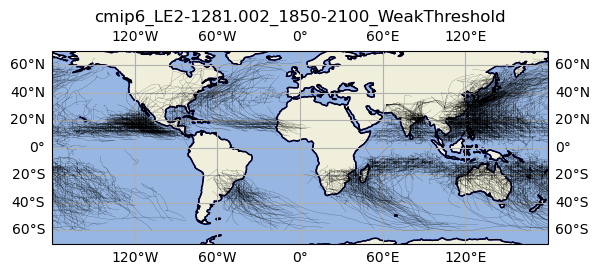

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.009_1850-2100_WeakThreshold.txt


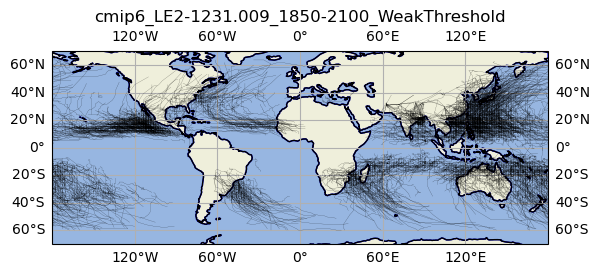

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.016_1850-2100_WeakThreshold.txt


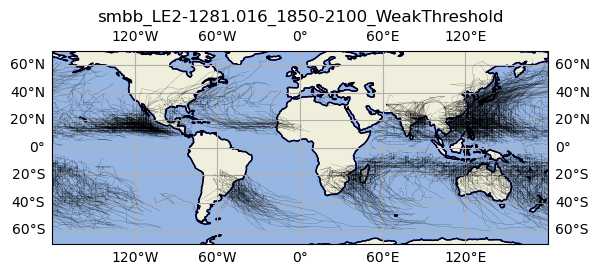

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.018_1850-2100_WeakThreshold.txt


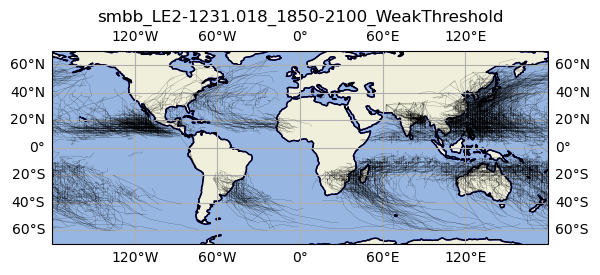

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.001_1850-2100_WeakThreshold.txt


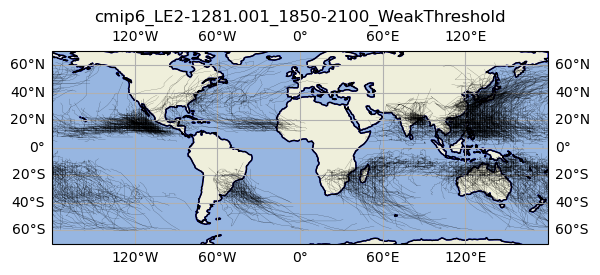

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.009_1850-2100_WeakThreshold.txt


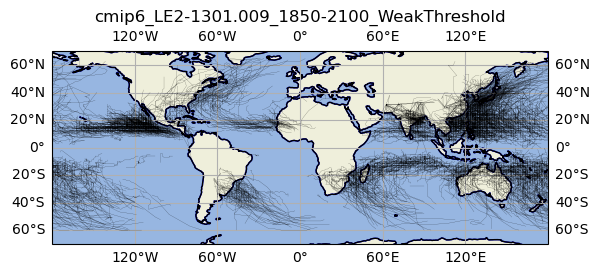

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1101.006_1850-2100_WeakThreshold.txt


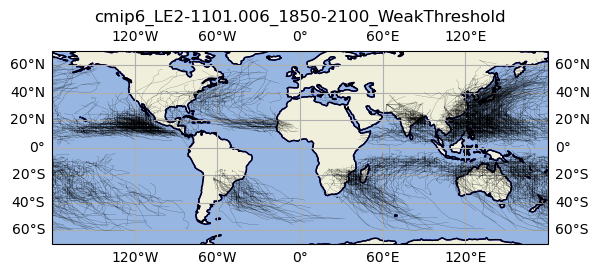

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1171.009_1850-2100_WeakThreshold.txt


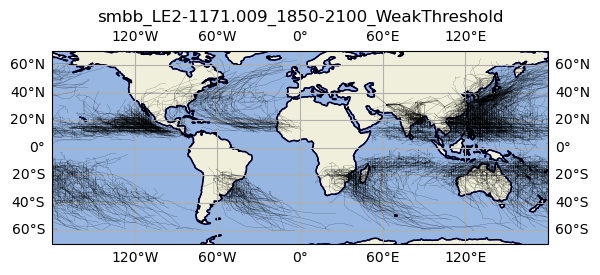

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.017_1850-2100_WeakThreshold.txt


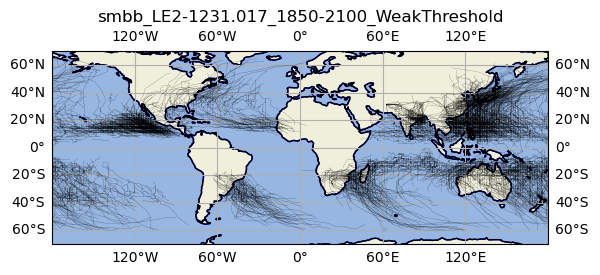

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.007_1850-2100_WeakThreshold.txt


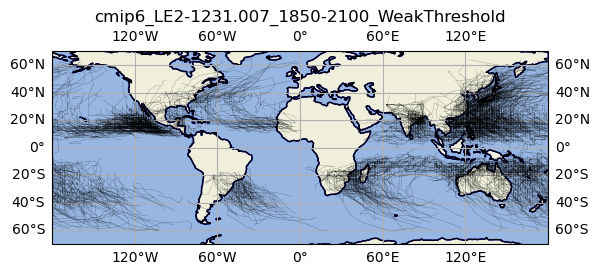

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1021.002_1850-2100_WeakThreshold.txt


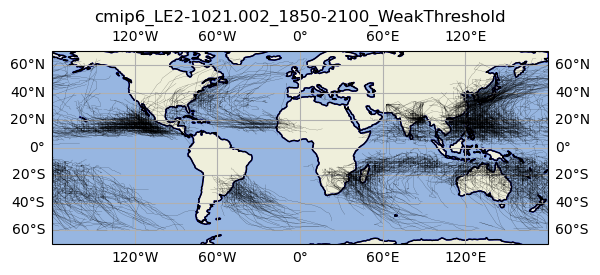

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.012_1850-2100_WeakThreshold.txt


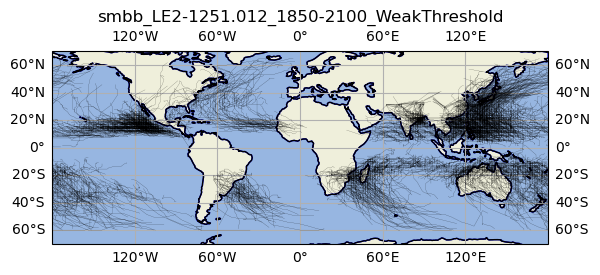

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.008_1850-2100_WeakThreshold.txt


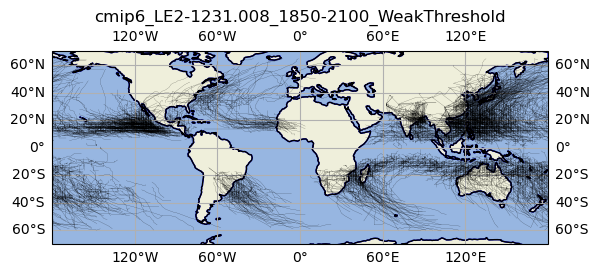

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.019_1850-2100_WeakThreshold.txt


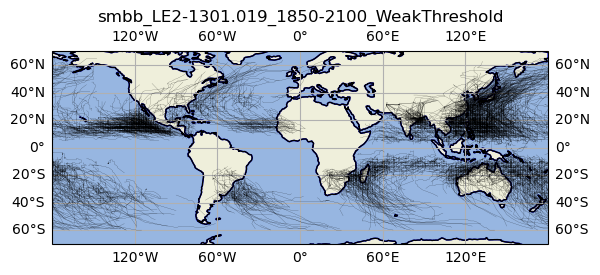

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.004_1850-2100_WeakThreshold.txt


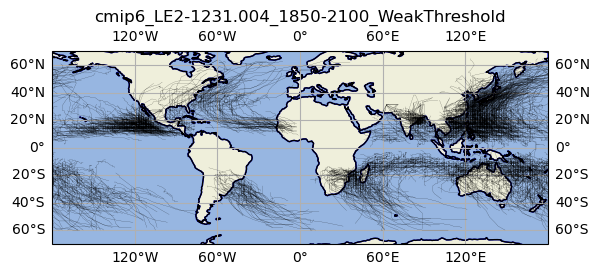

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.013_1850-2100_WeakThreshold.txt


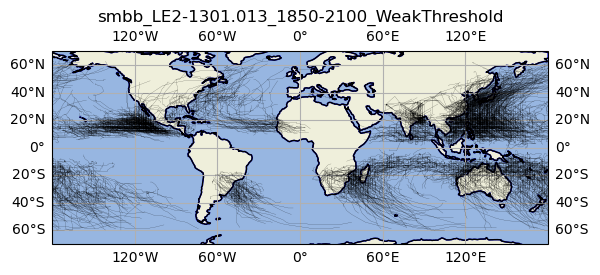

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1041.003_1850-2100_WeakThreshold.txt


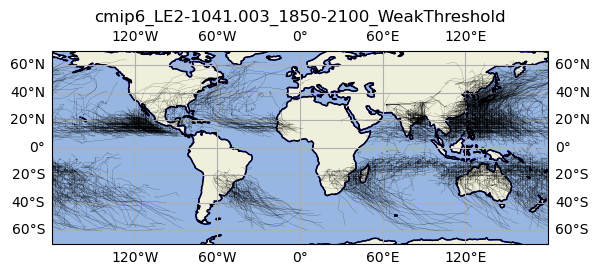

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1081.005_1850-2100_WeakThreshold.txt


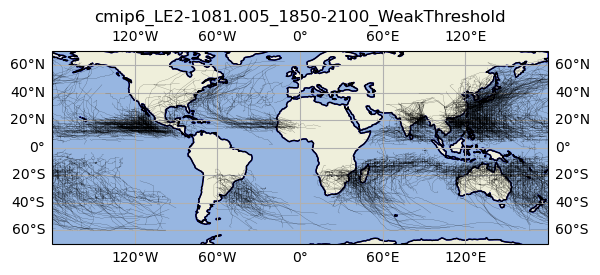

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1121.007_1850-2100_WeakThreshold.txt


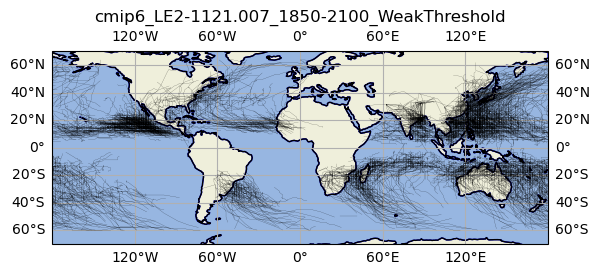

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.011_1850-2100_WeakThreshold.txt


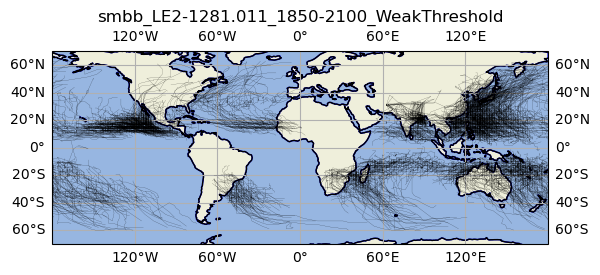

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.006_1850-2100_WeakThreshold.txt


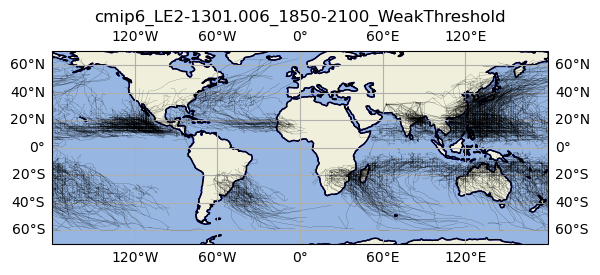

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.011_1850-2100_WeakThreshold.txt


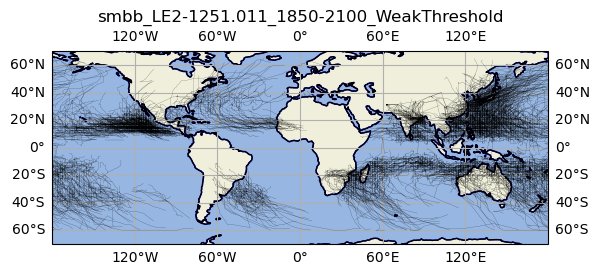

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.009_1850-2100_WeakThreshold.txt


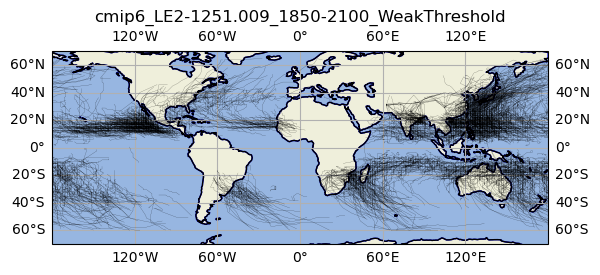

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.013_1850-2100_WeakThreshold.txt


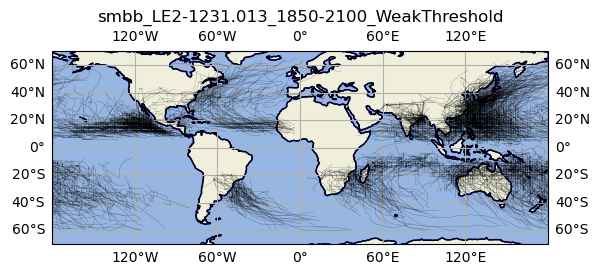

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1231.020_1850-2100_WeakThreshold.txt


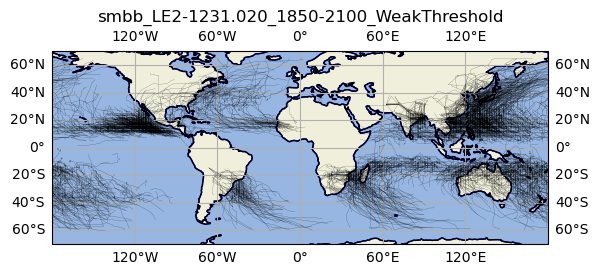

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.014_1850-2100_WeakThreshold.txt


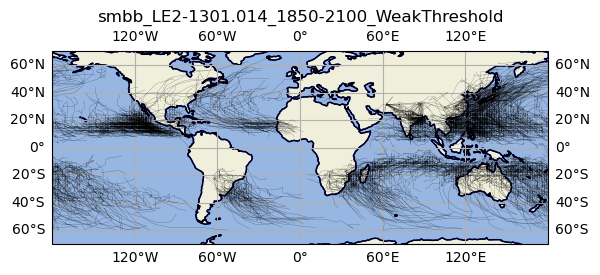

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.005_1850-2100_WeakThreshold.txt


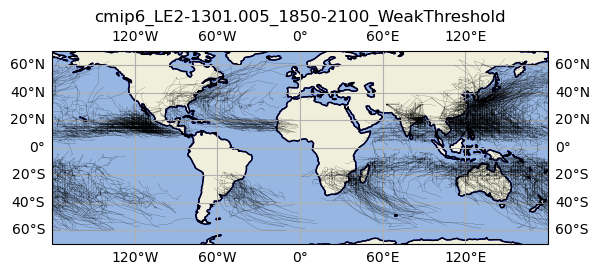

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.001_1850-2100_WeakThreshold.txt


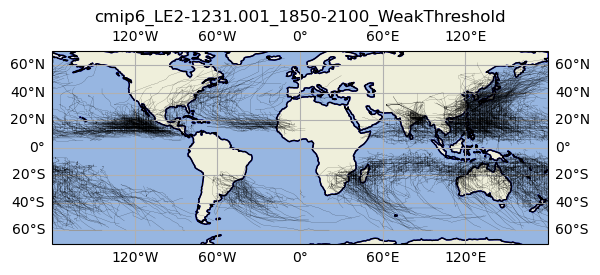

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.014_1850-2100_WeakThreshold.txt


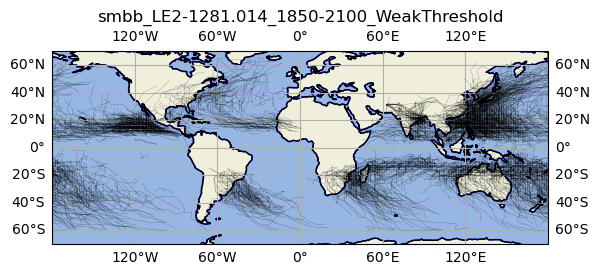

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1181.010_1850-2100_WeakThreshold.txt


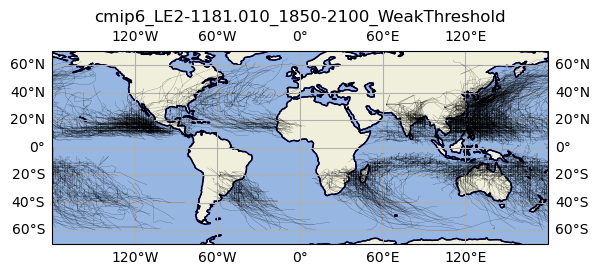

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1301.008_1850-2100_WeakThreshold.txt


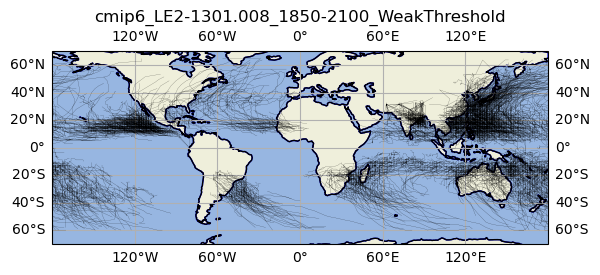

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.005_1850-2100_WeakThreshold.txt


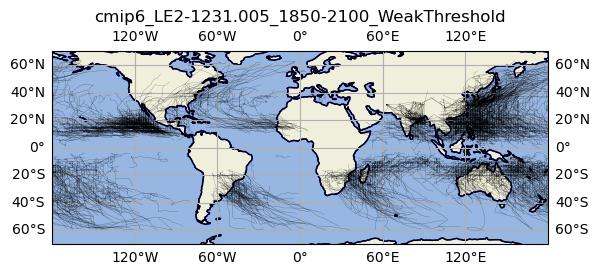

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1191.010_1850-2100_WeakThreshold.txt


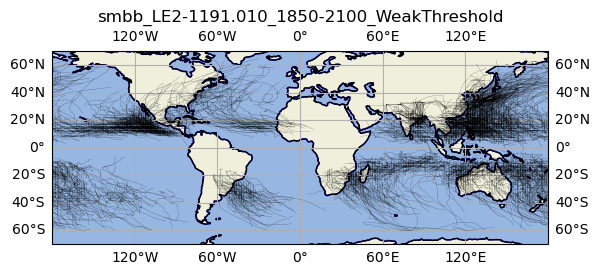

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.020_1850-2100_WeakThreshold.txt


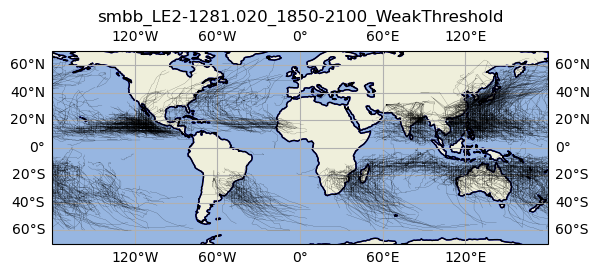

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.019_1850-2100_WeakThreshold.txt


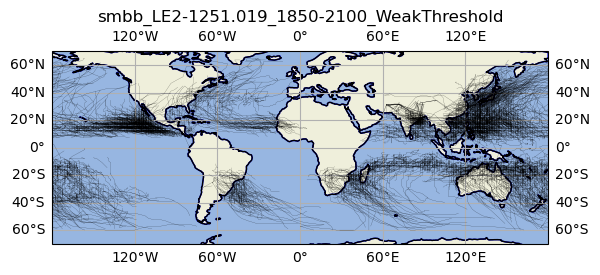

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.017_1850-2100_WeakThreshold.txt


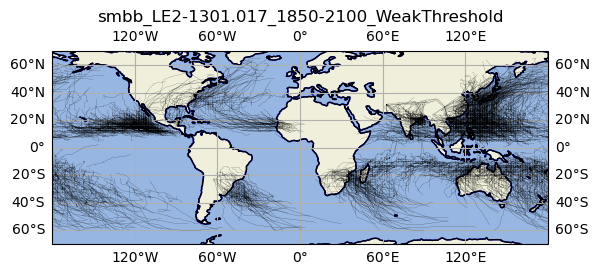

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.017_1850-2100_WeakThreshold.txt


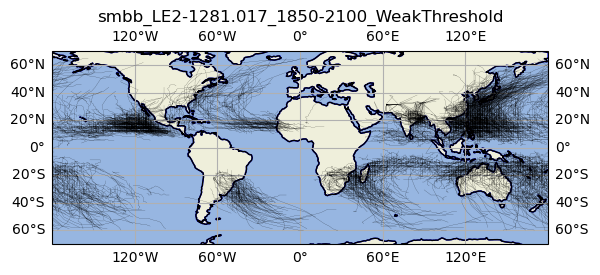

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.020_1850-2100_WeakThreshold.txt


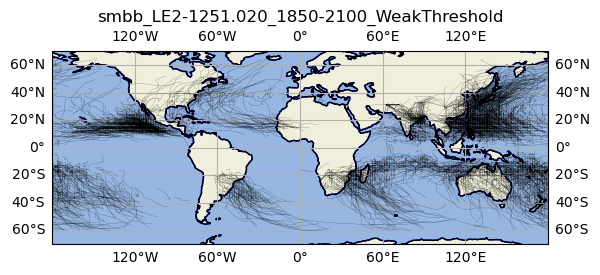

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.007_1850-2100_WeakThreshold.txt


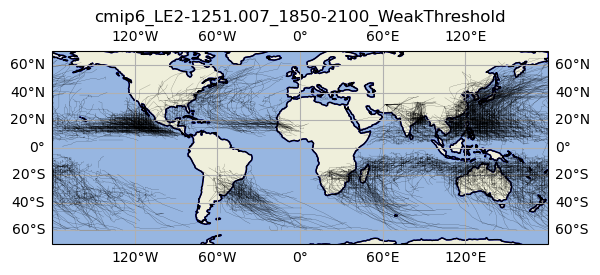

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1251.001_1850-2100_WeakThreshold.txt


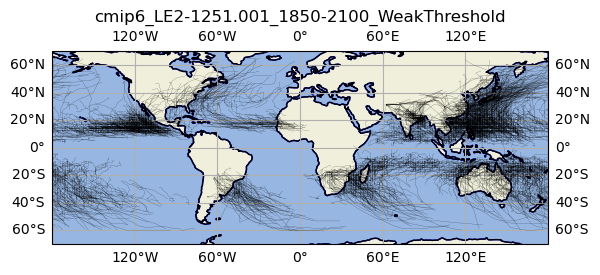

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1111.006_1850-2100_WeakThreshold.txt


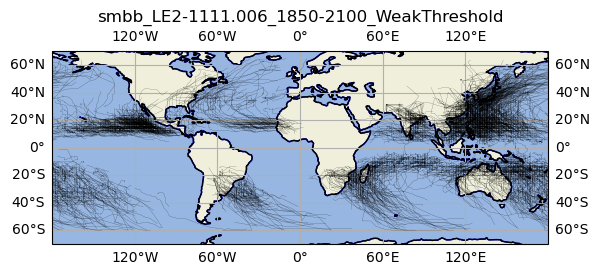

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1131.007_1850-2100_WeakThreshold.txt


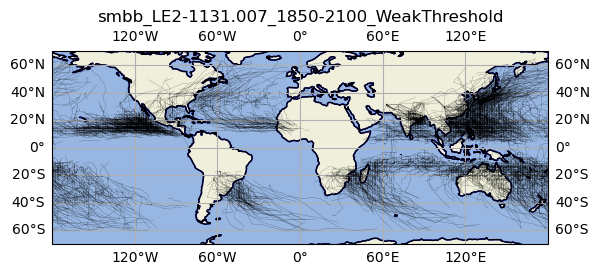

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.018_1850-2100_WeakThreshold.txt


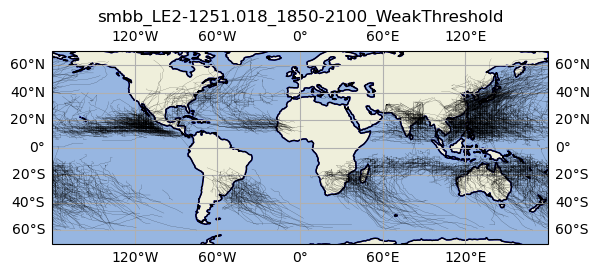

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1281.013_1850-2100_WeakThreshold.txt


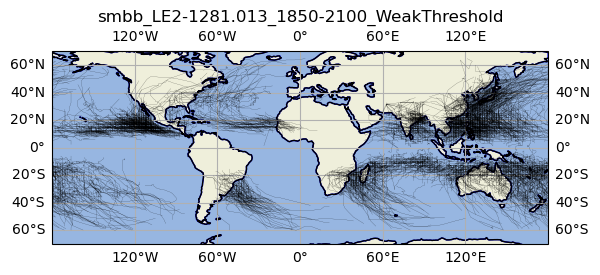

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.003_1850-2100_WeakThreshold.txt


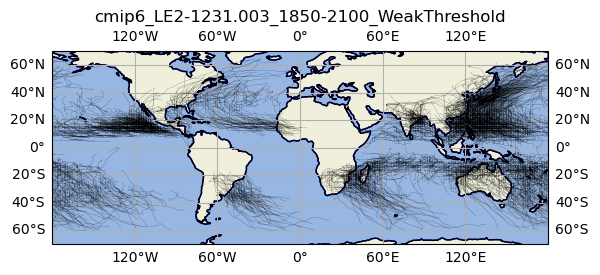

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.020_1850-2100_WeakThreshold.txt


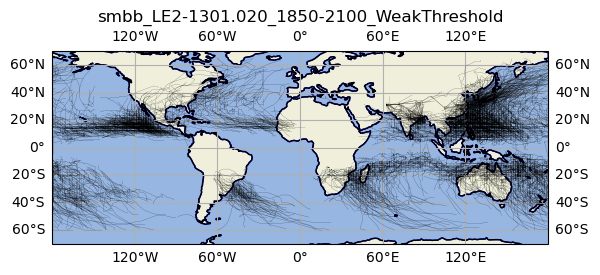

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1281.006_1850-2100_WeakThreshold.txt


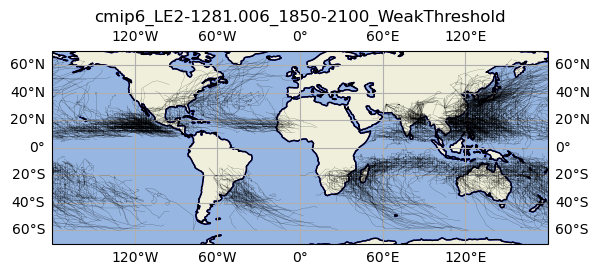

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1251.016_1850-2100_WeakThreshold.txt


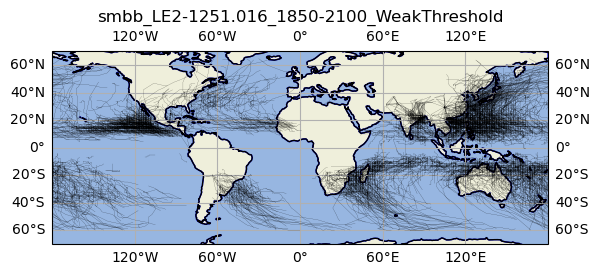

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.006_1850-2100_WeakThreshold.txt


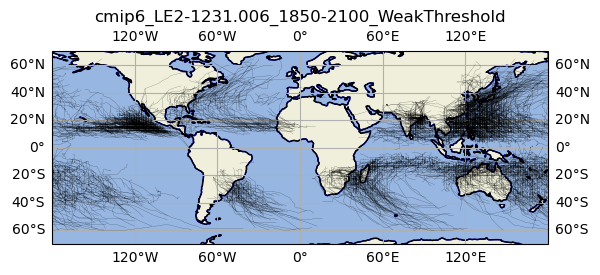

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1071.004_1850-2100_WeakThreshold.txt


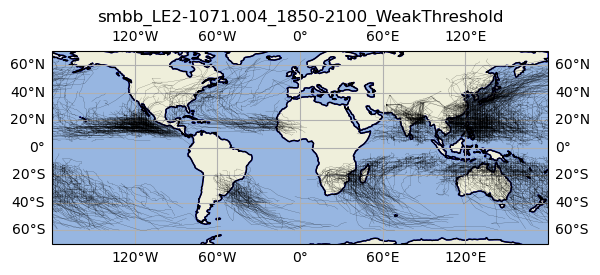

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_cmip6_LE2-1231.002_1850-2100_WeakThreshold.txt


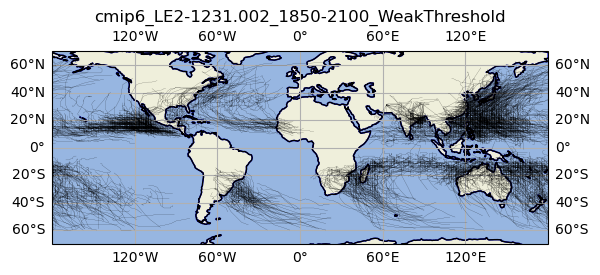

/glade/campaign/mmm/c3we/done/pcast/CESM2_LENS/CESM2_LENS_smbb_LE2-1301.012_1850-2100_WeakThreshold.txt


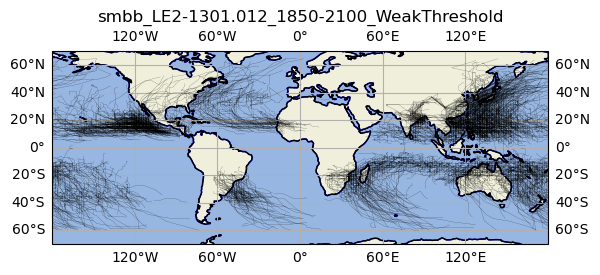

In [13]:
flnms = [ff for ff in glob.glob(dir_data + "*WeakThreshold.txt")]
n_f = len(flnms)
for flnm in flnms:
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.coastlines()
    ax.gridlines(draw_labels=True, dms=True, x_inline=False, y_inline=False)
    ax.set_extent([-180, 180, -70, 70])
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.LAND, edgecolor='b')

    print(flnm)
    ax.set_title(flnm[len(dir_data)+11:-4])
    df_tc = pd.read_csv(flnm, delimiter=', ', engine='python')
    # drop rows containing 'year' in column year
    df_tc = df_tc[~df_tc.year.str.contains("year")]
    
    years = df_tc.year
    years = np.unique(years)
   
    for year in range(year_s, year_e + 1):
        df = df_tc.loc[df_tc['year'].astype(int) == year]
        tc_ids = np.unique(df.track_id.astype(int))
        
        for tc_id in tc_ids:
            df_single = df.loc[df.track_id.astype(int) == tc_id]
             
            lat_1d = df_single.lat.values.astype(float) 
            lon_1d = df_single.lon.values.astype(float) 
            spd_1d = df_single.wind10.values.astype(float) 
            
            # discontinue at 180
            if  (lon_1d.max() - lon_1d.min()) >180:
                lon_1d =np.where(lon_1d > 180, lon_1d-360, lon_1d)
            
            col=colors.to_rgba(spd_1d)
            
        
        for nn in range(len(lon_1d)):      
            #ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree())
            ax.plot(lon_1d[nn], lat_1d[nn],  marker='.', markersize=0.2, color=col[nn,:], transform=ccrs.PlateCarree())
plt.colorbar(colors,fraction=0.1, pad=0.06,label='maximum_sustained_wind_speed (kt)', orientation='horizontal')   
 
            ax.plot(lon_1d, lat_1d, color='k', linewidth=0.1, transform=ccrs.PlateCarree()) 
    plt.show() 
  